# Regression Project: Predicting the Sale Prices of Homes in Seattle, Washington

Dataset is downloaded from Kaggle: https://www.kaggle.com/datasets/samuelcortinhas/house-price-prediction-seattle/code

In [1]:
# Importing the required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import matplotlib
matplotlib.rcParams['figure.figsize'] = (20, 10)


In [2]:
df_train = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')

In [3]:
df_train.head()

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price
0,3,2.5,2590.0,sqft,6000.00,sqft,98144,795000.0
1,4,2.0,2240.0,sqft,0.31,acre,98106,915000.0
2,4,3.0,2040.0,sqft,3783.00,sqft,98107,950000.0
3,4,3.0,3800.0,sqft,5175.00,sqft,98199,1950000.0
4,2,2.0,1042.0,sqft,NaN,NaN,98102,950000.0


In [4]:
df_train.shape, df_test.shape

((2016, 8), (505, 8))

In [5]:
df_train.info(), df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2016 entries, 0 to 2015
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   beds            2016 non-null   int64  
 1   baths           2016 non-null   float64
 2   size            2016 non-null   float64
 3   size_units      2016 non-null   object 
 4   lot_size        1669 non-null   float64
 5   lot_size_units  1669 non-null   object 
 6   zip_code        2016 non-null   int64  
 7   price           2016 non-null   float64
dtypes: float64(4), int64(2), object(2)
memory usage: 126.1+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 505 entries, 0 to 504
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   beds            505 non-null    int64  
 1   baths           505 non-null    float64
 2   size            505 non-null    float64
 3   size_units      505 non-null    object 
 4   l

(None, None)

## Exploring the dataset

Note that:
- beds = number of bedrooms in the house
- baths = number of bathrooms in the house and 0.5 means a half-bathroom which has a sink and a toilet but no shower or bathtub
- size = the size of the house in square feet
- size_units = the unit of the size of the house
- lot_size = the total area of the land where the property is located on. The lot belongs to the house owner.
- lot_size_units = the unit of the lot size
- zip_code = the zip code of the location of the house
- price = the price of the house in dollars (USD)
- 1 acre = 43560 square feet


In [6]:
# Checking for missing values
df_train.isnull().sum(), df_test.isnull().sum()

(beds                0
 baths               0
 size                0
 size_units          0
 lot_size          347
 lot_size_units    347
 zip_code            0
 price               0
 dtype: int64,
 beds               0
 baths              0
 size               0
 size_units         0
 lot_size          77
 lot_size_units    77
 zip_code           0
 price              0
 dtype: int64)

In [7]:
# Checking for the proportion of missing values in the dataset
df_train.isnull().sum()/df_train.shape[0]*100, df_test.isnull().sum()/df_test.shape[0]*100

(beds               0.000000
 baths              0.000000
 size               0.000000
 size_units         0.000000
 lot_size          17.212302
 lot_size_units    17.212302
 zip_code           0.000000
 price              0.000000
 dtype: float64,
 beds               0.000000
 baths              0.000000
 size               0.000000
 size_units         0.000000
 lot_size          15.247525
 lot_size_units    15.247525
 zip_code           0.000000
 price              0.000000
 dtype: float64)

Huge percentage of missing values in the lot_size column as well as the corresponding lot_size_units column in both datasets. We will assume that the minimum lot size  will be the size_unit, which is what we will use to fill it. This helps to logically ensure that the lot size is not less than the size of the house and deviation from the truth is minimal.

In [8]:
df_train[['size', 'size_units', 'lot_size', 'lot_size_units']].head()

,size,size_units,lot_size,lot_size_units
0,2590.0,sqft,6000.00,sqft
1,2240.0,sqft,0.31,acre
2,2040.0,sqft,3783.00,sqft
3,3800.0,sqft,5175.00,sqft
4,1042.0,sqft,NaN,NaN


In [9]:
df_train.groupby('lot_size_units')['lot_size_units'].count()

lot_size_units
acre     220
sqft    1449
Name: lot_size_units, dtype: int64

In [10]:
df_test.groupby('lot_size_units')['lot_size_units'].count()

lot_size_units
acre     59
sqft    369
Name: lot_size_units, dtype: int64

## Data Cleaning and Preprocessing

In [11]:
# Some values in the lot_size_units column are in acres and some are in sqft. We will convert all the values to sqft

# We will define a function to convert the values in the lot_size column to sqft
def convert_to_sqft(row):
    if row['lot_size_units'] == 'sqft':
        return row['lot_size']
    else:
        return row['lot_size']*43560

In [12]:
# Applying the function to the dataset
df_train['lot_size'] = df_train.apply(lambda row: convert_to_sqft(row), axis=1)

In [13]:
df_train.head()

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price
0,3,2.5,2590.0,sqft,6000.0,sqft,98144,795000.0
1,4,2.0,2240.0,sqft,13503.6,acre,98106,915000.0
2,4,3.0,2040.0,sqft,3783.0,sqft,98107,950000.0
3,4,3.0,3800.0,sqft,5175.0,sqft,98199,1950000.0
4,2,2.0,1042.0,sqft,NaN,NaN,98102,950000.0


In [14]:
df_test['lot_size'] = df_test.apply(lambda row: convert_to_sqft(row), axis=1)

In [15]:
df_test.head()

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price
0,3,3.0,2850.0,sqft,4200.0,sqft,98119,1175000.0
1,4,5.0,3040.0,sqft,5002.0,sqft,98106,1057500.0
2,3,1.0,1290.0,sqft,6048.0,sqft,98125,799000.0
3,3,2.0,2360.0,sqft,12196.8,acre,98188,565000.0
4,3,3.5,1942.0,sqft,1603.0,sqft,98107,1187000.0


In [16]:
# Changing the lot_size_units column to sqft
df_train['lot_size_units'] = 'sqft'
df_test['lot_size_units'] = 'sqft'


In [17]:
df_train.head()

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price
0,3,2.5,2590.0,sqft,6000.0,sqft,98144,795000.0
1,4,2.0,2240.0,sqft,13503.6,sqft,98106,915000.0
2,4,3.0,2040.0,sqft,3783.0,sqft,98107,950000.0
3,4,3.0,3800.0,sqft,5175.0,sqft,98199,1950000.0
4,2,2.0,1042.0,sqft,NaN,sqft,98102,950000.0


In [18]:
# Dealing with missing values

#1. Finding the average lot_size:size and applying it to the missing values
df_train['avg_lot_ratio'] = df_train['lot_size']/df_train['size']
df_train.head()

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price,avg_lot_ratio
0,3,2.5,2590.0,sqft,6000.0,sqft,98144,795000.0,2.316602
1,4,2.0,2240.0,sqft,13503.6,sqft,98106,915000.0,6.028393
2,4,3.0,2040.0,sqft,3783.0,sqft,98107,950000.0,1.854412
3,4,3.0,3800.0,sqft,5175.0,sqft,98199,1950000.0,1.361842
4,2,2.0,1042.0,sqft,NaN,sqft,98102,950000.0,NaN


In [19]:
df_train['avg_lot_ratio'].mean()

38.00439044304304

In [20]:
df_train['avg_lot_ratio'].median()

2.334375

In [21]:
df_train['avg_lot_ratio'].max()

43560.0

The data above implies that the dataset is likely heavily skewed to the right (positively skewed) probably due the presence of outliers or extremely high values in the dataset

In [22]:
# Sorting and showing the biggest ten values

df_train.sort_values(by='avg_lot_ratio', na_position='first').tail(20)


,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price,avg_lot_ratio
645,2,2.5,1365.0,sqft,176418.0,sqft,98118,525000.0,129.243956
952,2,2.0,877.0,sqft,114562.8,sqft,98115,415000.0,130.630331
1394,2,2.0,1006.0,sqft,144619.2,sqft,98112,650000.0,143.756660
266,2,2.0,1245.0,sqft,179031.6,sqft,98168,330000.0,143.800482
1908,2,2.5,1138.0,sqft,172933.2,sqft,98126,515000.0,151.962390
1451,2,1.0,885.0,sqft,154202.4,sqft,98105,389000.0,174.240000
783,1,1.0,626.0,sqft,114562.8,sqft,98115,275000.0,183.007668
465,2,1.0,903.0,sqft,176853.6,sqft,98146,363500.0,195.851163
1218,2,1.0,903.0,sqft,176853.6,sqft,98146,312500.0,195.851163
596,2,2.0,1415.0,sqft,278784.0,sqft,98125,449000.0,197.020495


In [23]:
df_train[df_train['avg_lot_ratio'] > 1000]

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price,avg_lot_ratio
770,1,1.0,250.0,sqft,10890000.0,sqft,98103,159000.0,43560.000000
1225,1,1.0,564.0,sqft,4356000.0,sqft,98103,602000.0,7723.404255


Average lot ratio greater than 1000  are massive outliers and would not be used.

In [24]:
# Removing the outliers

df_train = df_train[df_train['avg_lot_ratio'] < 1000]
df_train.shape

(1667, 9)

In [25]:
# Counting the number of missing values in the lot_size column, it should be 2 more than the previous count

df_train['lot_size'].isnull().sum()

0

As for the test dataset, we will remove all NaN values in the lot_size column so as to avoid any errors.

In [26]:
df_test = df_test.dropna(subset=['lot_size'])

In [27]:
df_test.isnull().sum()

beds              0
baths             0
size              0
size_units        0
lot_size          0
lot_size_units    0
zip_code          0
price             0
dtype: int64

In [28]:
df_train.head()

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price,avg_lot_ratio
0,3,2.5,2590.0,sqft,6000.0,sqft,98144,795000.0,2.316602
1,4,2.0,2240.0,sqft,13503.6,sqft,98106,915000.0,6.028393
2,4,3.0,2040.0,sqft,3783.0,sqft,98107,950000.0,1.854412
3,4,3.0,3800.0,sqft,5175.0,sqft,98199,1950000.0,1.361842
5,2,2.0,1190.0,sqft,43560.0,sqft,98107,740000.0,36.605042


In [29]:
# Zipcode column issue
df_train['zip_code'].nunique()

27

In [30]:
# Converting the zip_code to a categorical variable

df_train['zip_code'] = df_train['zip_code'].astype('category')
df_test['zip_code'] = df_test['zip_code'].astype('category')

In [31]:
df_train.info()
df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1667 entries, 0 to 2015
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   beds            1667 non-null   int64   
 1   baths           1667 non-null   float64 
 2   size            1667 non-null   float64 
 3   size_units      1667 non-null   object  
 4   lot_size        1667 non-null   float64 
 5   lot_size_units  1667 non-null   object  
 6   zip_code        1667 non-null   category
 7   price           1667 non-null   float64 
 8   avg_lot_ratio   1667 non-null   float64 
dtypes: category(1), float64(5), int64(1), object(2)
memory usage: 120.1+ KB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 428 entries, 0 to 504
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   beds            428 non-null    int64   
 1   baths           428 non-null    float64 
 2   size            42

In [32]:
# Removing bedrooms and bathrooms outliers
def remove_bed_outliers(df):
    exclude_indices = np.array([])
    for zipcode, zipcode_df in df.groupby('zip_code'):
        beds_stats = {}
        for beds, beds_df in zipcode_df.groupby('beds'):
            beds_stats[beds] = {
                'count': beds_df.shape[0],
                'mean_price': beds_df['price'].mean(),
                'std_price': beds_df['price'].std()
            }
        for beds, beds_df in zipcode_df.groupby('beds'):
            stats = beds_stats.get(beds-1)
            if stats and stats['count']>5:
                exclude_indices = np.append(exclude_indices, beds_df[beds_df['price']<(stats['mean_price'])].index.values)
    return df.drop(exclude_indices, axis='index')

df_train_0 = remove_bed_outliers(df_train)
df_train_0.shape

(1399, 9)

In [33]:
# view distribution per zipcode
df_train_0['zip_code'].value_counts()

98117    127
98115    127
98103    115
98144     89
98107     73
98122     69
98106     68
98126     62
98125     62
98118     58
98116     57
98199     55
98133     47
98136     47
98119     42
98105     38
98112     37
98109     36
98146     35
98168     34
98108     30
98102     25
98178     24
98177     21
98121     12
98104      6
98101      3
Name: zip_code, dtype: int64

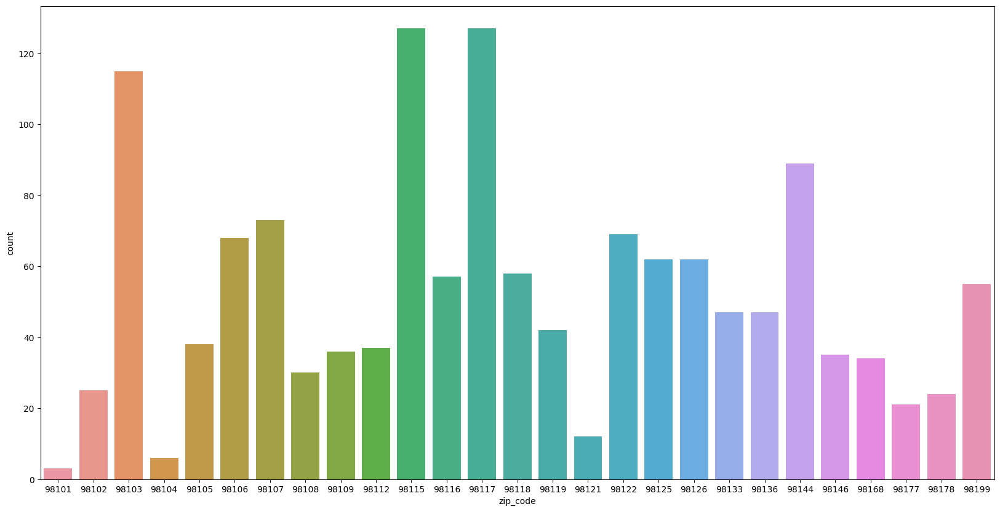

In [34]:
# Visualizing the distribution of the zip_code column
plt.figure(figsize=(20, 10))
sns.countplot(x='zip_code', data=df_train_0)
plt.show()


In [35]:
df_train_0.baths.unique()

array([2.5, 2. , 3. , 1. , 3.5, 1.5, 5.5, 5. , 4. , 8.5, 4.5, 6. , 0.5,
       7. , 9. , 6.5])

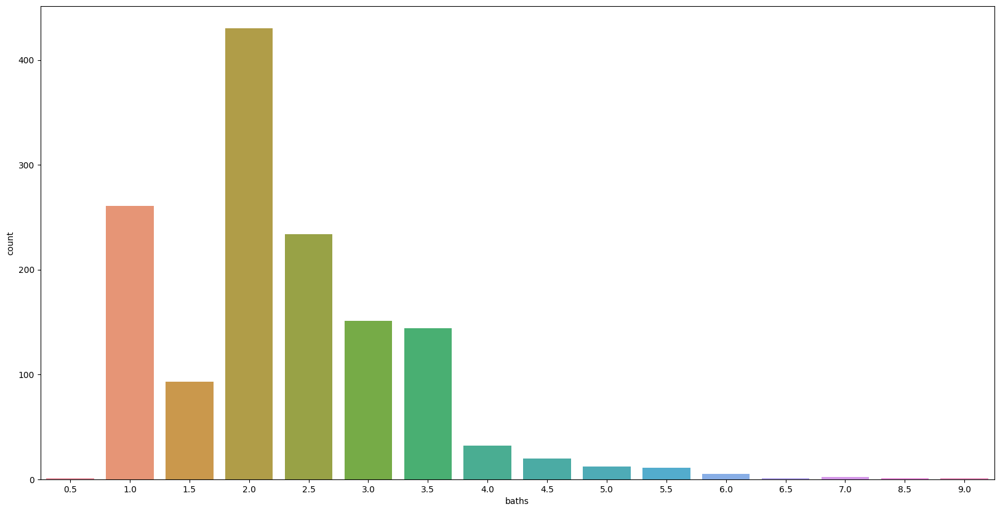

In [36]:
# Visualizing the distribution of the baths column
plt.figure(figsize=(20, 10))
sns.countplot(x='baths', data=df_train_0)
plt.show()

In [37]:
df_train_0[df_train_0.baths > df_train_0.beds+2]

,beds,baths,size,size_units,lot_size,lot_size_units,zip_code,price,avg_lot_ratio
128,5,8.5,3110.0,sqft,4455.0,sqft,98115,1606500.0,1.432476
313,2,5.5,1320.0,sqft,1250.0,sqft,98144,679950.0,0.946970
598,2,4.5,1670.0,sqft,905.0,sqft,98107,1115000.0,0.541916
637,2,5.5,2659.0,sqft,22651.2,sqft,98102,6250000.0,8.518691
875,3,7.0,2190.0,sqft,5504.0,sqft,98112,1868000.0,2.513242
1672,2,4.5,1840.0,sqft,1500.0,sqft,98103,1049000.0,0.815217


In [38]:
# Removing the baths outliers
df_train_1 = df_train_0[df_train_0.baths <= df_train_0.beds+2]
df_train_1.shape

(1393, 9)

In [41]:
# Performing one hot encoding on the zip_code column
df_train_2 = pd.get_dummies(df_train_1, columns=['zip_code'])
df_train_2.drop(['zip_code_98101', 'zip_code_98104'], axis=1, inplace=True)
df_train_2.head()

,beds,baths,size,size_units,lot_size,lot_size_units,price,avg_lot_ratio,zip_code_98102,zip_code_98103,...,zip_code_98125,zip_code_98126,zip_code_98133,zip_code_98136,zip_code_98144,zip_code_98146,zip_code_98168,zip_code_98177,zip_code_98178,zip_code_98199
0,3,2.5,2590.0,sqft,6000.0,sqft,795000.0,2.316602,0,0,...,0,0,0,0,1,0,0,0,0,0
1,4,2.0,2240.0,sqft,13503.6,sqft,915000.0,6.028393,0,0,...,0,0,0,0,0,0,0,0,0,0
2,4,3.0,2040.0,sqft,3783.0,sqft,950000.0,1.854412,0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,3.0,3800.0,sqft,5175.0,sqft,1950000.0,1.361842,0,0,...,0,0,0,0,0,0,0,0,0,1
5,2,2.0,1190.0,sqft,43560.0,sqft,740000.0,36.605042,0,0,...,0,0,0,0,0,0,0,0,0,0


In [42]:
df_test_2 = pd.get_dummies(df_test, columns=['zip_code'])
df_test_2.drop(['size_units', 'zip_code_98188'], axis=1, inplace=True)
df_test_2.head()

,beds,baths,size,lot_size,lot_size_units,price,zip_code_98102,zip_code_98103,zip_code_98105,zip_code_98106,...,zip_code_98125,zip_code_98126,zip_code_98133,zip_code_98136,zip_code_98144,zip_code_98146,zip_code_98168,zip_code_98177,zip_code_98178,zip_code_98199
0,3,3.0,2850.0,4200.0,sqft,1175000.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,4,5.0,3040.0,5002.0,sqft,1057500.0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,3,1.0,1290.0,6048.0,sqft,799000.0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
3,3,2.0,2360.0,12196.8,sqft,565000.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,3,3.5,1942.0,1603.0,sqft,1187000.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Checking Correlation between the features and the target variable

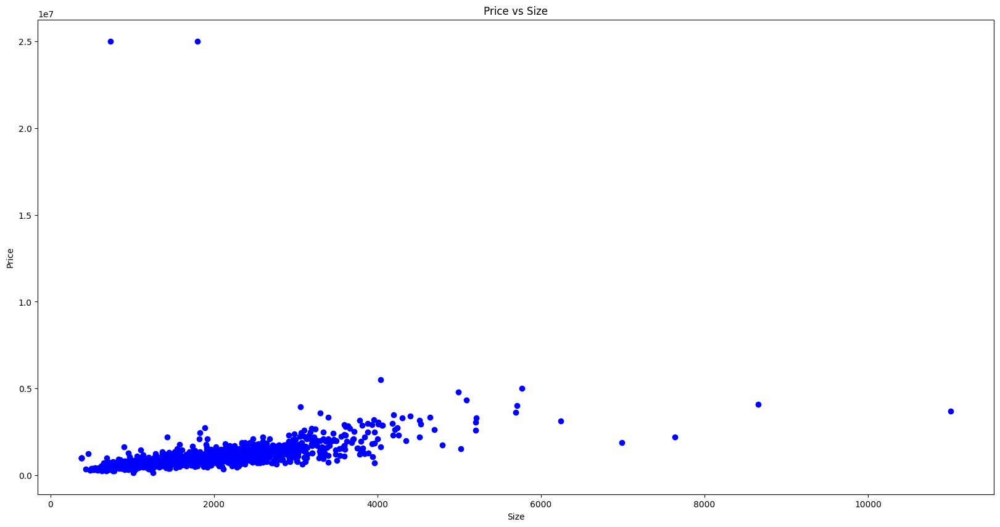

In [43]:
plt.scatter(df_train_2['size'], df_train_2['price'], color='blue')
plt.title('Price vs Size')
plt.xlabel('Size')
plt.ylabel('Price')
plt.show()

In [44]:
# Checking the two outliers in the price column
df_train_2['price'].sort_values(ascending=False).head()

1700    25000000.0
1359    25000000.0
61       5495000.0
805      5000000.0
1998     4815000.0
Name: price, dtype: float64

In [45]:
# Removing the two outliers in the price column
price_outliers = df_train_2['price'].sort_values(ascending=False).head(2).index
df_train_3 = df_train_2.drop(price_outliers)

## Building Regression Model

In [46]:
X_train = df_train_3.drop(['price', 'avg_lot_ratio', 'size_units', 'lot_size_units'], axis=1)
X_train.head()

,beds,baths,size,lot_size,zip_code_98102,zip_code_98103,zip_code_98105,zip_code_98106,zip_code_98107,zip_code_98108,...,zip_code_98125,zip_code_98126,zip_code_98133,zip_code_98136,zip_code_98144,zip_code_98146,zip_code_98168,zip_code_98177,zip_code_98178,zip_code_98199
0,3,2.5,2590.0,6000.0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,4,2.0,2240.0,13503.6,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,4,3.0,2040.0,3783.0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,4,3.0,3800.0,5175.0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
5,2,2.0,1190.0,43560.0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


In [47]:
y_train = df_train_3['price']
y_train.head()

0     795000.0
1     915000.0
2     950000.0
3    1950000.0
5     740000.0
Name: price, dtype: float64

In [48]:
X_test = df_test_2.drop(['price', 'lot_size_units'], axis=1)
X_test.head()

,beds,baths,size,lot_size,zip_code_98102,zip_code_98103,zip_code_98105,zip_code_98106,zip_code_98107,zip_code_98108,...,zip_code_98125,zip_code_98126,zip_code_98133,zip_code_98136,zip_code_98144,zip_code_98146,zip_code_98168,zip_code_98177,zip_code_98178,zip_code_98199
0,3,3.0,2850.0,4200.0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,4,5.0,3040.0,5002.0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,1.0,1290.0,6048.0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
3,3,2.0,2360.0,12196.8,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,3,3.5,1942.0,1603.0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


In [49]:
y_test = df_test_2['price']
y_test.head()

0    1175000.0
1    1057500.0
2     799000.0
3     565000.0
4    1187000.0
Name: price, dtype: float64

In [50]:
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

def find_best_model(X_train, y_train):
    algos = {
        'linear_regression': {
            'model': LinearRegression(),
            'params': {
                'fit_intercept': [True, False]
            }
        },
        'ridge': {
            'model': Ridge(),
            'params': {
                'alpha': [1, 5, 10, 50],
                'solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga'],
                'max_iter': [1000, 2000, 3000]
            }
        },
        'lasso': {
            'model': Lasso(),
            'params': {
                'alpha': [1, 5, 10, 50],
                'selection': ['cyclic', 'random'],
                'max_iter': [1000, 2000, 3000]
            }
        },
        'decision_tree': {
            'model': DecisionTreeRegressor(),
            'params': {
                'criterion': ['squared_error', 'friedman_mse', 'absolute_error', 'poisson'],
                'splitter': ['best', 'random']
            }
        },
        'random_forest': {
            'model': RandomForestRegressor(),
            'params': {
                'n_estimators': [50, 100, 200],
                'max_depth': [None, 10, 20],
                'min_samples_split': [2, 5, 10],
                'min_samples_leaf': [1, 2, 4],
                'max_features': ['auto', 'sqrt', 'log2']
            }
        },
        'gradient_boosting': {
            'model': GradientBoostingRegressor(),
            'params': {
                'n_estimators': [50, 100, 200],
                'learning_rate': [0.01, 0.1, 0.2],
                'max_depth': [3, 5, 7],
                'min_samples_split': [2, 5, 10],
                'min_samples_leaf': [1, 2, 4],
                'max_features': ['auto', 'sqrt', 'log2']
            }
        }
    }

    scores = []
    cv = ShuffleSplit(n_splits=5, random_state=1)
    for algo_name, config in algos.items():
        gs = GridSearchCV(config['model'], config['params'], cv=cv, return_train_score=False)
        gs.fit(X_train, y_train)
        scores.append({
            'model': algo_name,
            'best_score': gs.best_score_,
            'best_params': gs.best_params_
        })

    return pd.DataFrame(scores, columns=['model', 'best_score', 'best_params'])

result = find_best_model(X_train, y_train)
result


c:\Python311\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Python311\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Python311\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Python311\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Python311\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.982e+13, tolerance: 4.345e+10
  model = cd_fast.enet_coordinate_desce

,model,best_score,best_params
0,linear_regression,0.704014,{'fit_intercept': True}
1,ridge,0.704672,"{'alpha': 1, 'max_iter': 1000, 'solver': 'auto'}"
2,lasso,0.704304,"{'alpha': 50, 'max_iter': 1000, 'selection': '..."
3,decision_tree,0.606822,"{'criterion': 'poisson', 'splitter': 'random'}"
4,random_forest,0.773052,"{'max_depth': 20, 'max_features': 'log2', 'min..."
5,gradient_boosting,0.795196,"{'learning_rate': 0.1, 'max_depth': 7, 'max_fe..."


In [51]:
result.best_params[5]

{'learning_rate': 0.1,
 'max_depth': 7,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 10,
 'n_estimators': 100}

In [52]:
# Best algorithm is the gradient boosting model giving a best score of 0.795 ~ 80%
# Using the best parameters to train the model

model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=7, min_samples_split=10, min_samples_leaf=1, max_features='sqrt')

model.fit(X_train, y_train)

GradientBoostingRegressor(max_depth=7, max_features='sqrt',
                          min_samples_split=10)

In [53]:
# Checking the accuracy of the model
model.score(X_test, y_test)

0.5827651295792395

## Prediction and Evaluation of the Model

In [60]:
y_hat = model.predict(X_test)

In [62]:
from sklearn.metrics import mean_squared_error

mse = mean_squared_error(y_test, y_hat)

print('Mean Squared Error:', mse)

Mean Squared Error: 159464959534.84677


In [63]:
y_hat_df = pd.DataFrame(y_hat, columns=['Predicted Price'])
y_hat_df.head()

,Predicted Price
0,1.362945e+06
1,1.221251e+06
2,6.832710e+05
3,1.085686e+06
4,1.160133e+06


In [70]:
y_test_array = np.array(y_test)
y_test_df = pd.DataFrame(y_test_array, columns=['Actual Price'])
y_test_df.head()

,Actual Price
0,1175000.0
1,1057500.0
2,799000.0
3,565000.0
4,1187000.0


In [71]:
y_test_y_hat = pd.concat([y_test_df, y_hat_df], axis=1)
y_test_y_hat.head()

,Actual Price,Predicted Price
0,1175000.0,1.362945e+06
1,1057500.0,1.221251e+06
2,799000.0,6.832710e+05
3,565000.0,1.085686e+06
4,1187000.0,1.160133e+06


In [72]:
price_corr = y_test_y_hat.corr()
price_corr

,Actual Price,Predicted Price
Actual Price,1.00000,0.77745
Predicted Price,0.77745,1.00000


In [73]:
print('The correlation between the actual price and the predicted price is: %.2f' % price_corr.iloc[0, 1])

The correlation between the actual price and the predicted price is: 0.78


In [75]:
import pickle
with open('Seattle_Home_Prices_Prediction_Model.pickle', 'wb') as f:
    pickle.dump(model, f)

In [76]:
import json
columns = {
    'data_columns': [col.lower() for col in X_train.columns]
}
with open('columns.json', 'w') as f:
    f.write(json.dumps(columns))